In [5]:
import librosa
import librosa.display
import pandas as pd

import numpy as np

import matplotlib.pyplot as plt

%matplotlib inline

import os

from PIL import Image

import pathlib

import csv

# Preprocessing

from sklearn.model_selection import train_test_split

from sklearn.preprocessing import LabelEncoder, StandardScaler

#Keras

import keras

import warnings

warnings.filterwarnings('ignore')

In [6]:
df = pd.read_csv('train.csv')
df

,track,views,country,score
0,normalize_5s_intro_thc1MtNagC8.wav,38319601,NaN,0.676471
1,normalize_5s_intro_Wo2qUD1g7xM.wav,71940972,VN,0.666667
2,normalize_5s_intro_3ObVN3QQiZ8.wav,28548855,FR,0.447368
3,normalize_5s_intro_S-zQJFRX5Fg.wav,310197,NaN,0.876712
4,normalize_5s_intro_SyZOAgXiPMw.wav,1283578,NaN,0.325000
...,...,...,...,...
215,normalize_5s_intro_gDevCxVY_wA.wav,3649493,NaN,0.550000
216,normalize_5s_intro_IrtcCSE2bVY.wav,765625,RO,0.465753
217,normalize_5s_intro_feVUoKhP1mE.wav,71109,NaN,0.518519
218,normalize_5s_intro_Tfypj4UwvvA.wav,39196,US,0.734940


In [7]:
def data_preprocess(file_des, df, train=True):
    # train_data
    mfcc_train = []
    melspec_train = []
    mfcc_test = []
    melspec_test = []
    y_train = []
    header = 'filename chroma_stft spectral_centroid spectral_bandwidth rolloff zero_crossing_rate'

    for i in range(1, 21):

        header += f' mfcc{i}'
    if train:
        header += ' label'

    header = header.split()
    file = open(file_des, 'w', newline='')

    with file:

        writer = csv.writer(file)

        writer.writerow(header)
    for index, row in df.iterrows():
        fig, ax = plt.subplots()
        file_path = os.path.join('audios/clips', row['track'])
        y, sr = librosa.load(file_path, mono=True, duration=5)
        chroma_stft = librosa.feature.chroma_stft(y=y, sr=sr)

        spec_cent = librosa.feature.spectral_centroid(y=y, sr=sr)

        spec_bw = librosa.feature.spectral_bandwidth(y=y, sr=sr)

        rolloff = librosa.feature.spectral_rolloff(y=y, sr=sr)

        zcr = librosa.feature.zero_crossing_rate(y)

        mfcc = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=128)
        mels = librosa.feature.melspectrogram(y=y, sr=sr)
        mels = librosa.power_to_db(mels, ref=np.max)
        img = librosa.display.specshow(mels, x_axis='time',
                         y_axis='mel', sr=sr,
                         fmax=8000, ax=ax)
        fig.colorbar(img, ax=ax, format='%+2.0f dB')
        ax.set(title='Mel-frequency spectrogram')
        print(mels.shape)
        if train:
            mfcc_train.append(mfcc)
            melspec_train.append(mels)
        else:
            mfcc_test.append(mfcc)
            melspec_test.append(mels)
        to_append = f'{row["track"]} {np.mean(chroma_stft)} {np.mean(spec_cent)} {np.mean(spec_bw)} {np.mean(rolloff)} {np.mean(zcr)}'    

        for e in mfcc:

            to_append += f' {np.mean(e)}'
        
        if train:
            to_append += f' {row["score"]}'
            y_train.append(row['score'])
        file = open(file_des, 'a', newline='')

        with file:

            writer = csv.writer(file)

            writer.writerow(to_append.split())
    if train:
        y_train = np.array(y_train)
        mfcc_data = np.array(mfcc_train)
        melspec_data = np.array(melspec_train)
        np.save('y_train', y_train)
        np.save('mfcc_train', mfcc_data)
        np.save('melspec_train', melspec_data)
    else:
        mfcc_data = np.array(mfcc_test)
        melspec_data = np.array(melspec_test)
        np.save('mfcc_test', mfcc_data)
        np.save('melspec_test', melspec_data)


(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)

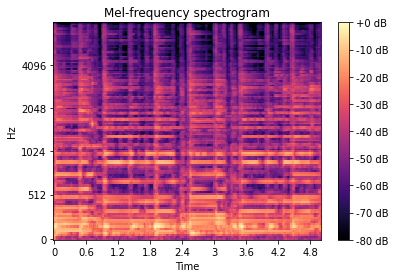

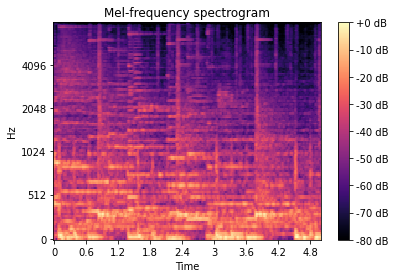

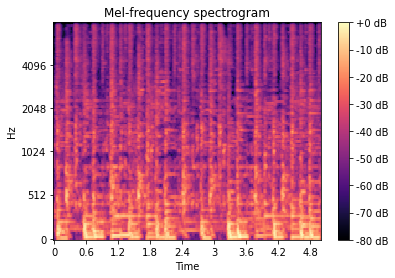

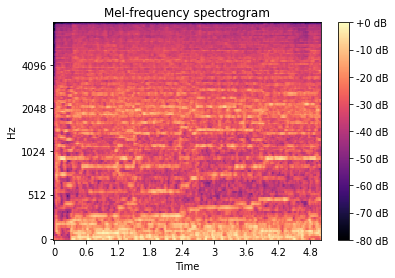

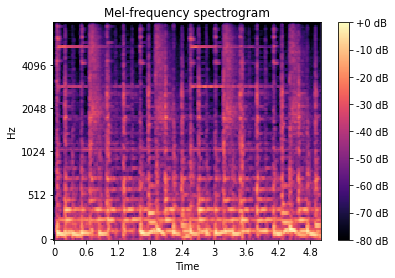

...

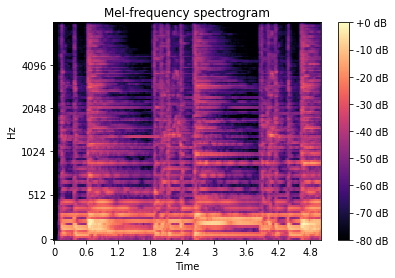

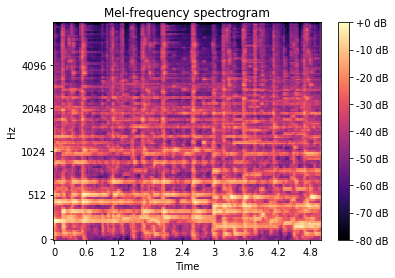

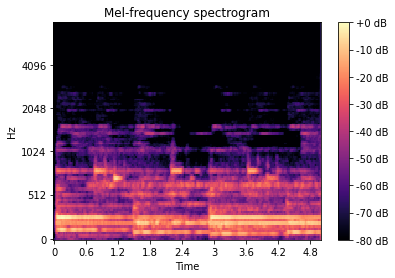

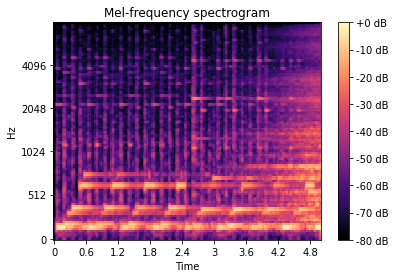

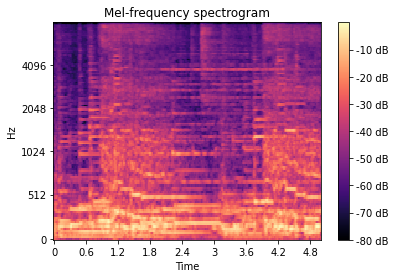

In [8]:
data_preprocess('data_train.csv', df, train=True)

(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)
(128, 216)


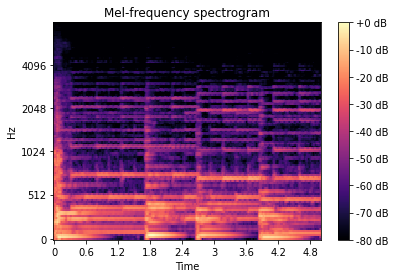

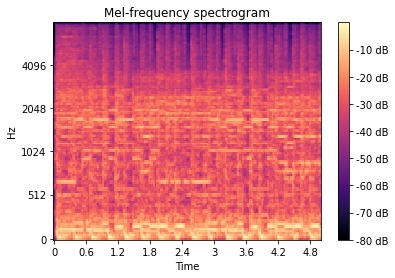

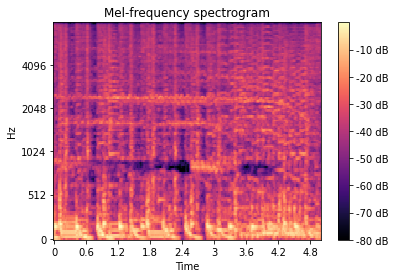

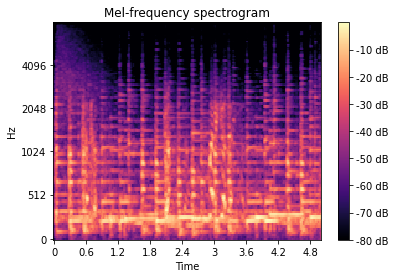

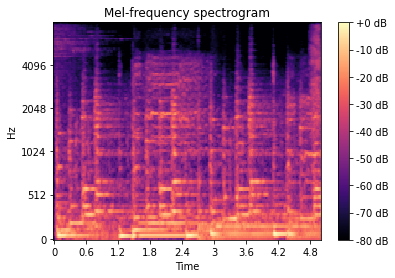

...

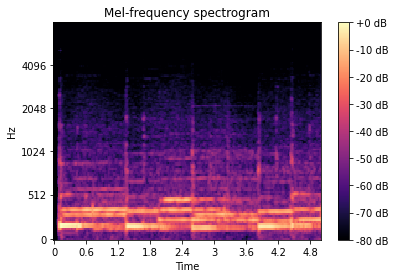

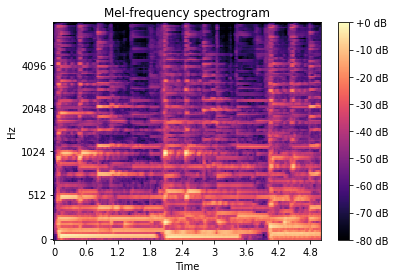

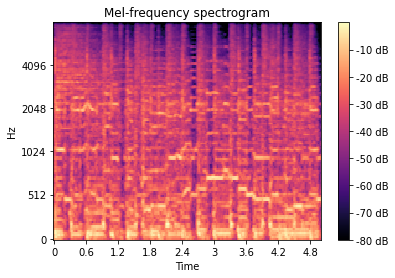

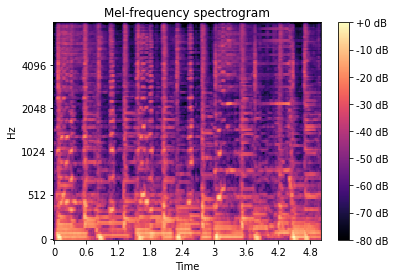

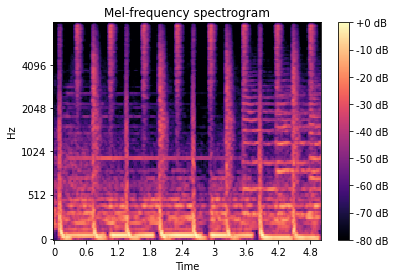

In [9]:

df_test = pd.read_csv('test.csv')
df_test
data_preprocess('data_test.csv', df_test, train=False)

In [10]:
data = pd.read_csv('data_train.csv')

data.head()
data.shape

(220, 27)